In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import time

import os
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sys
from collections import Counter

from PIL import Image
from torchvision import datasets

from sklearn.manifold import TSNE

# Load Dataset

In [2]:
dataset = datasets.ImageFolder('../datasets/train_data')

class_names = dataset.classes
num_classes = len(class_names)

total_images = len(dataset)

print(f'Total images: {total_images}')
print(f'Number of classes: {num_classes}')
print(f'Class names: {class_names}')

Total images: 4485
Number of classes: 3
Class names: ['cherry', 'strawberry', 'tomato']


# Cleanvision analysis
### `pip install cleanvision`

Checking for dark, light, odd_aspect_ratio, low_information, exact_duplicates, near_duplicates, blurry, grayscale, odd_size images ...


  0%|          | 0/4485 [00:00<?, ?it/s]

  0%|          | 0/4485 [00:00<?, ?it/s]

Issue checks completed. 139 issues found in the dataset. To see a detailed report of issues found, use imagelab.report().
Issues found in images in order of severity in the dataset

|    | issue_type       |   num_images |
|---:|:-----------------|-------------:|
|  0 | odd_size         |           53 |
|  1 | exact_duplicates |           39 |
|  2 | near_duplicates  |           32 |
|  3 | blurry           |            9 |
|  4 | dark             |            3 |
|  5 | low_information  |            3 |
|  6 | light            |            0 |
|  7 | odd_aspect_ratio |            0 |
|  8 | grayscale        |            0 | 

--------------------- odd_size images ----------------------

Number of examples with this issue: 53
Examples representing most severe instances of this issue:



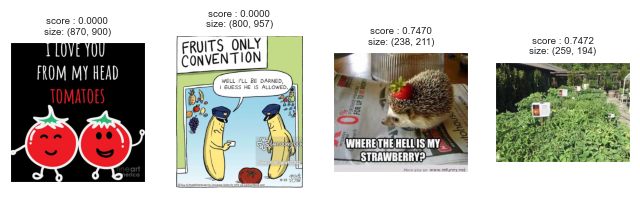

----------------- exact_duplicates images ------------------

Number of examples with this issue: 39
Examples representing most severe instances of this issue:

Set: 0


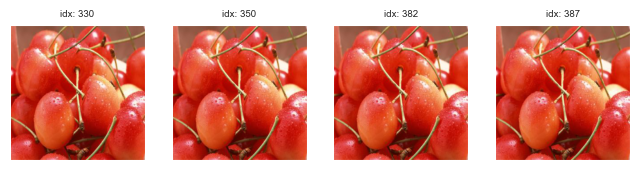

Set: 1


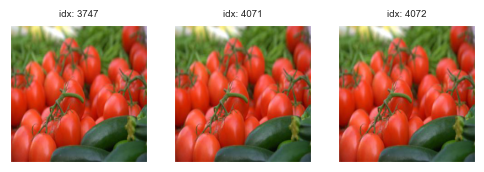

Set: 2


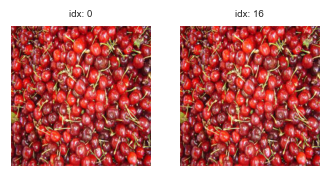

Set: 3


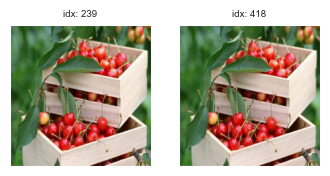

------------------ near_duplicates images ------------------

Number of examples with this issue: 32
Examples representing most severe instances of this issue:

Set: 0


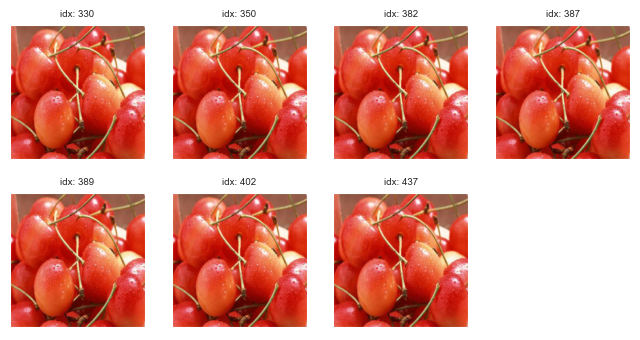

Set: 1


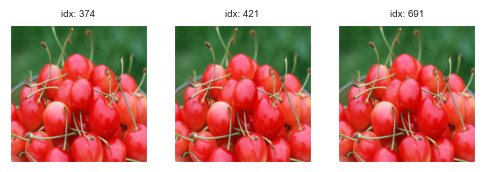

Set: 2


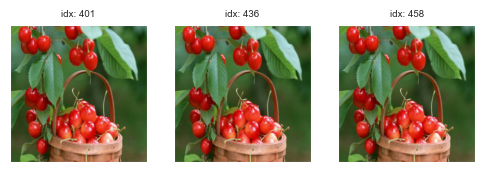

Set: 3


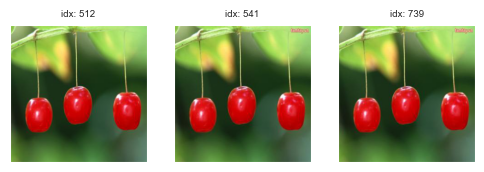

---------------------- blurry images -----------------------

Number of examples with this issue: 9
Examples representing most severe instances of this issue:



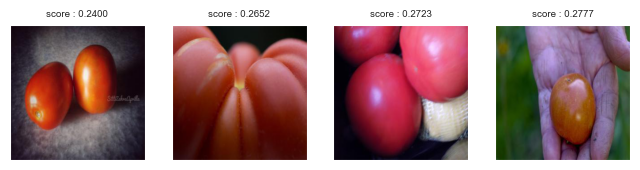

----------------------- dark images ------------------------

Number of examples with this issue: 3
Examples representing most severe instances of this issue:



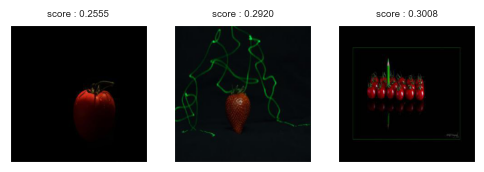

------------------ low_information images ------------------

Number of examples with this issue: 3
Examples representing most severe instances of this issue:



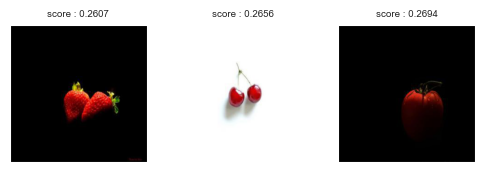

In [8]:
from cleanvision import Imagelab

# Specify path to folder containing the image files in your dataset
imagelab = Imagelab(torchvision_dataset=dataset)

# Automatically check for a predefined list of issues within your dataset
imagelab.find_issues()

# Produce a neat report of the issues found in your dataset
imagelab.report()

# Displaying Images

In [9]:
import matplotlib.pyplot as plt
from PIL import Image

def display_images(image_paths, titles):
    num_images = len(image_paths)
    plt.figure(figsize=(15, 5))
    for i, img_path in enumerate(image_paths):
        with Image.open(img_path) as img:
            plt.subplot(1, num_images, i+1)
            plt.imshow(img)
            plt.title(titles[i])
            plt.axis('off')
    plt.show()

In [10]:
issues_df = imagelab.issues
issues_df.head()

,odd_size_score,is_odd_size_issue,odd_aspect_ratio_score,is_odd_aspect_ratio_issue,low_information_score,is_low_information_issue,light_score,is_light_issue,grayscale_score,is_grayscale_issue,dark_score,is_dark_issue,blurry_score,is_blurry_issue,exact_duplicates_score,is_exact_duplicates_issue,near_duplicates_score,is_near_duplicates_issue
0,1.0,False,1.0,False,0.892709,False,0.840766,False,1,False,0.876075,False,0.597051,False,0.5,True,1.0,False
1,1.0,False,1.0,False,0.824814,False,0.824195,False,1,False,0.713827,False,0.595413,False,1.0,False,1.0,False
2,1.0,False,1.0,False,0.941016,False,0.955440,False,1,False,0.987540,False,0.653028,False,1.0,False,1.0,False
3,1.0,False,1.0,False,0.935833,False,0.892249,False,1,False,0.958599,False,0.591594,False,1.0,False,1.0,False
4,1.0,False,1.0,False,0.918473,False,0.846965,False,1,False,0.845595,False,0.484446,False,1.0,False,1.0,False


### Odd Size (Weird images e.g. strawberry shortcake logo)

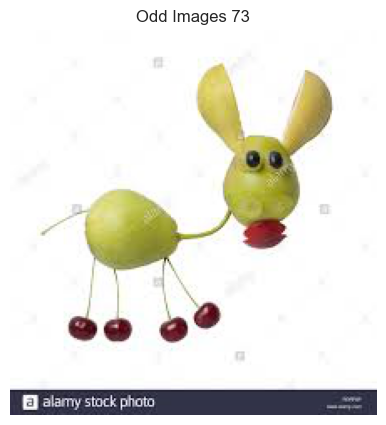

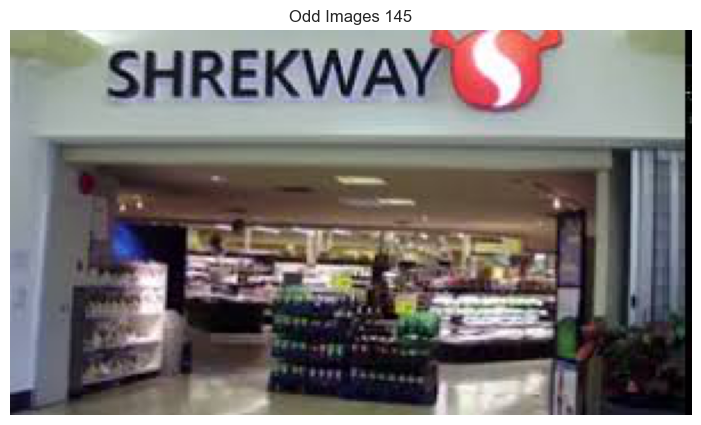

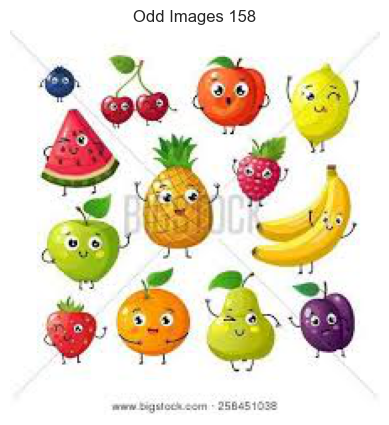

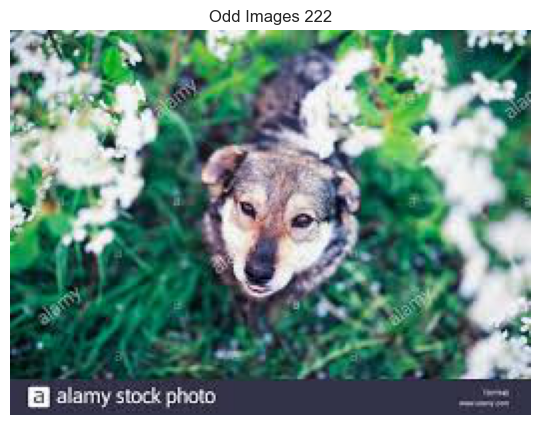

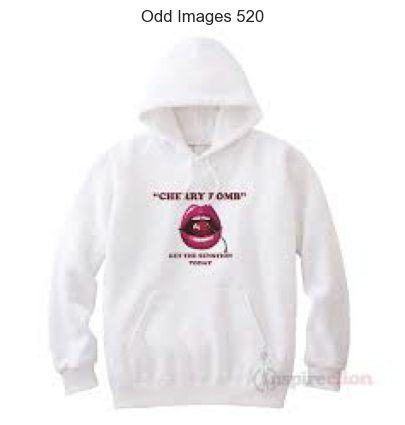

...

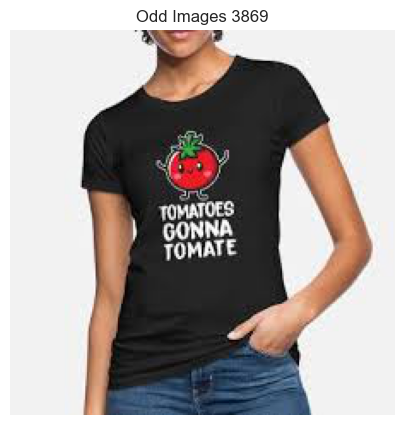

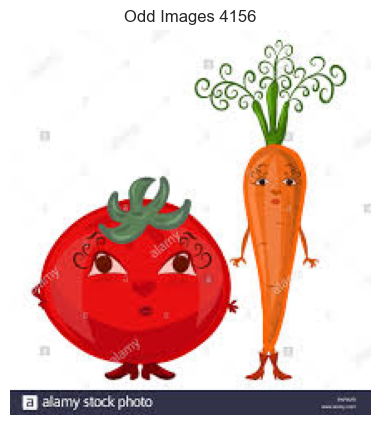

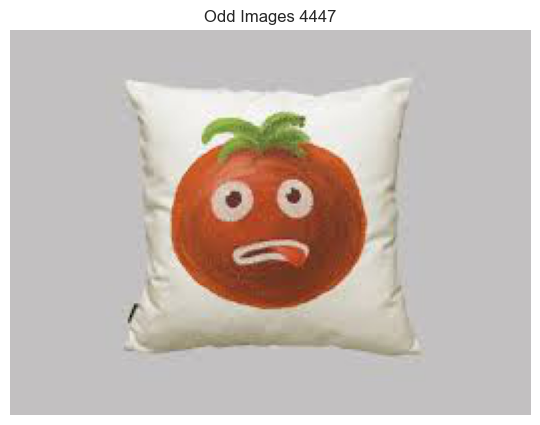

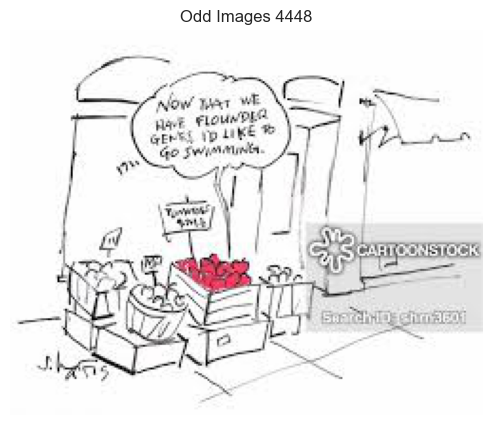

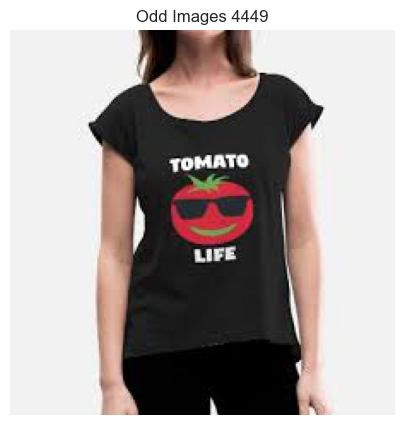

In [11]:
odd_size_indices = issues_df.index[issues_df['is_odd_size_issue'] == True].tolist()
all_image_paths = [sample[0] for sample in dataset.samples]

for idx in odd_size_indices:
        img_path = all_image_paths[idx]
        title = f"Odd Images {idx}"
        display_images([img_path], [title])

In [12]:
odd_size_indices

[73,
 145,
 158,
 222,
 520,
 542,
 621,
 632,
 633,
 634,
 666,
 726,
 853,
 854,
 855,
 1172,
 1437,
 1538,
 1539,
 1540,
 1740,
 1752,
 1813,
 1879,
 1932,
 2075,
 2130,
 2213,
 2284,
 2309,
 2310,
 2466,
 2562,
 2728,
 2914,
 3056,
 3057,
 3093,
 3097,
 3098,
 3099,
 3100,
 3101,
 3149,
 3184,
 3296,
 3342,
 3355,
 3869,
 4156,
 4447,
 4448,
 4449]

### Exact duplicates (double checked and they all were duplicates)

Total exact duplicate images to remove: 21


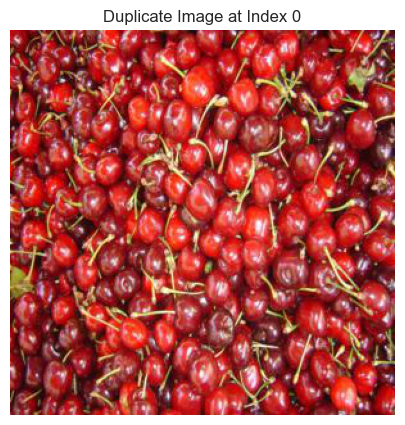

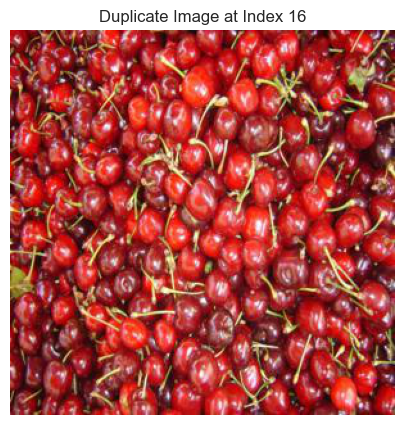

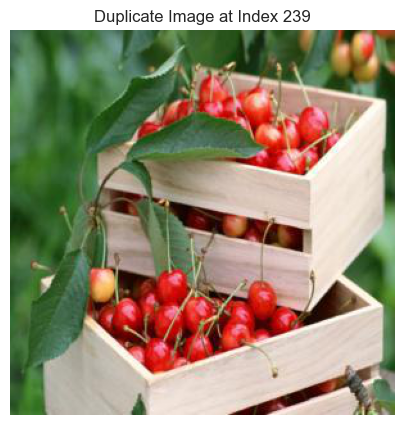

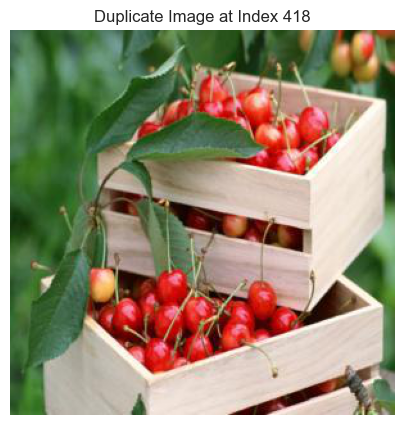

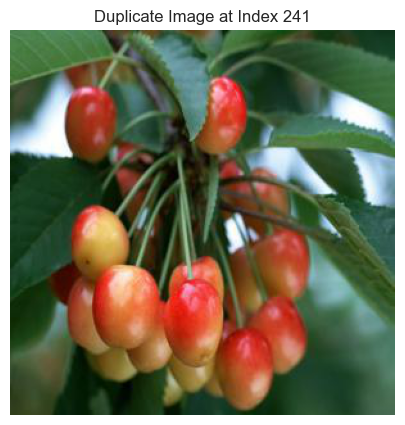

...

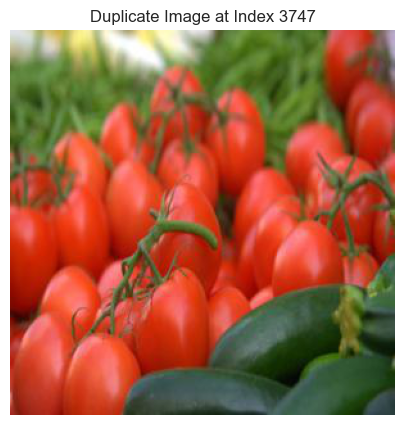

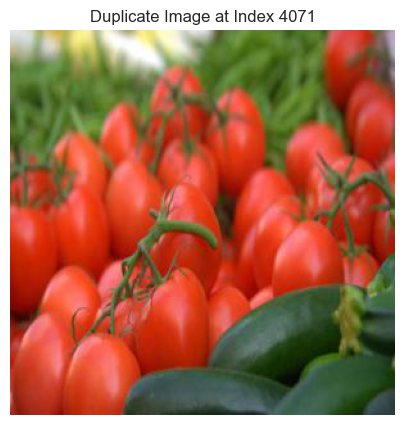

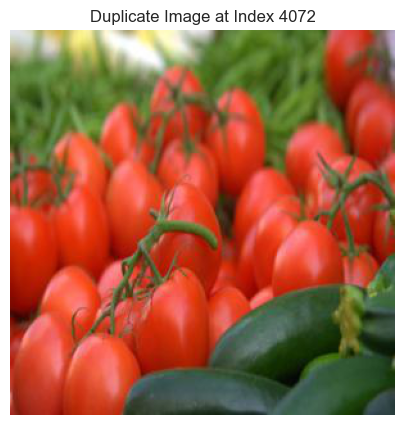

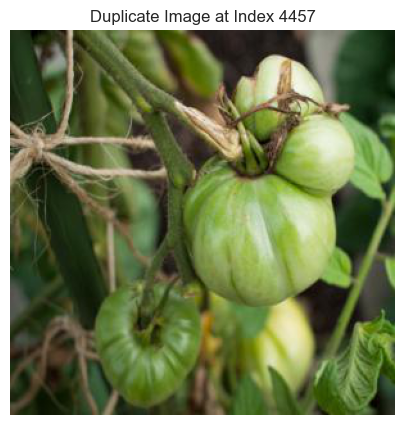

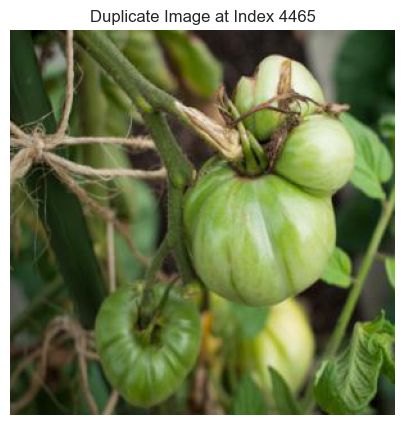

In [13]:
exact_duplicates = imagelab.info['exact_duplicates']['sets']
all_image_paths = [sample[0] for sample in dataset.samples]

exact_duplicate_indices_to_remove = []

for dup_set in exact_duplicates:
    duplicates = dup_set[1:]
    exact_duplicate_indices_to_remove.extend(duplicates)

print(f"Total exact duplicate images to remove: {len(exact_duplicate_indices_to_remove)}")
for _ in exact_duplicates:
    for idx in _:
        img_path = all_image_paths[idx]
        title = f"Duplicate Image at Index {idx}"
        display_images([img_path], [title])

In [14]:
exact_duplicate_indices_to_remove

[16,
 418,
 695,
 350,
 382,
 387,
 691,
 402,
 444,
 862,
 916,
 995,
 1592,
 2929,
 3118,
 3245,
 3542,
 3949,
 4071,
 4072,
 4465]

### 'Near Duplicates' however all were exact

Total near duplicate images to remove: 20


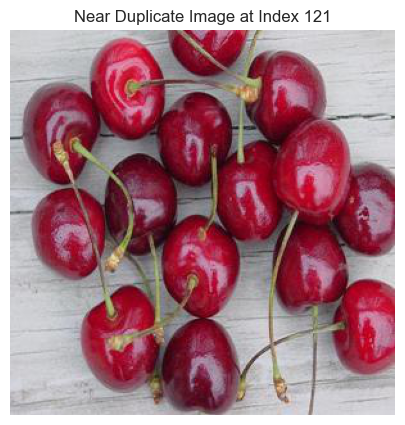

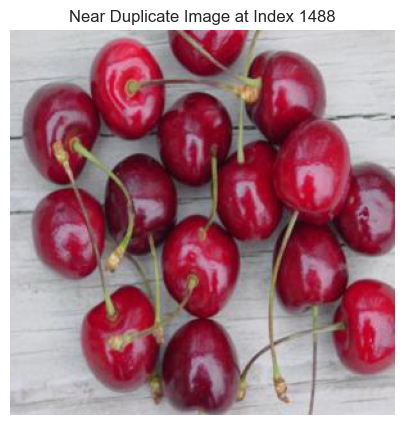

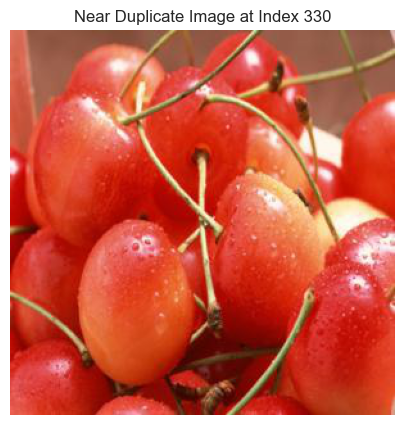

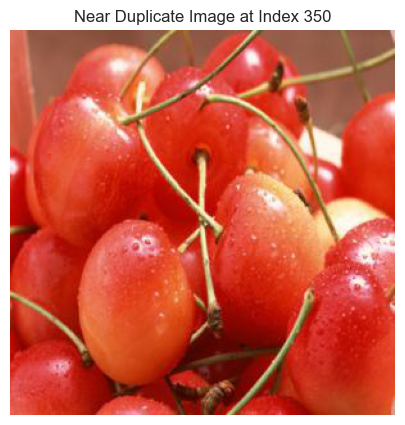

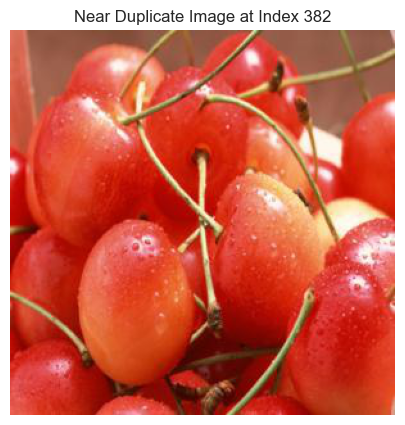

...

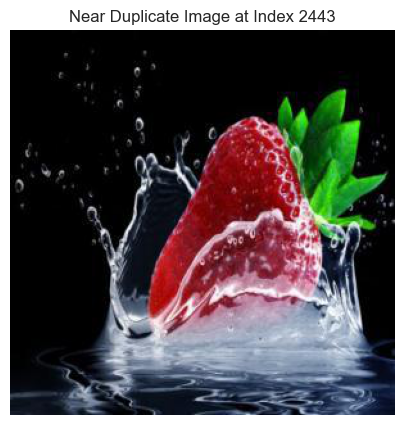

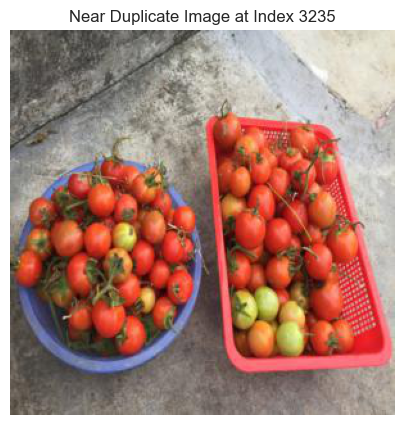

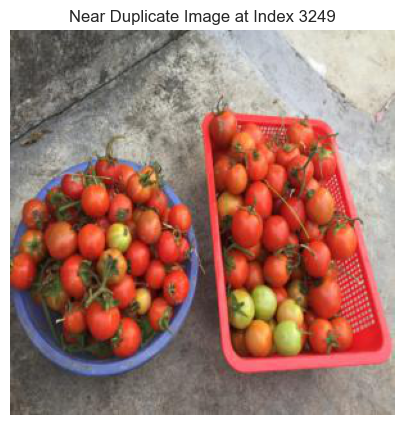

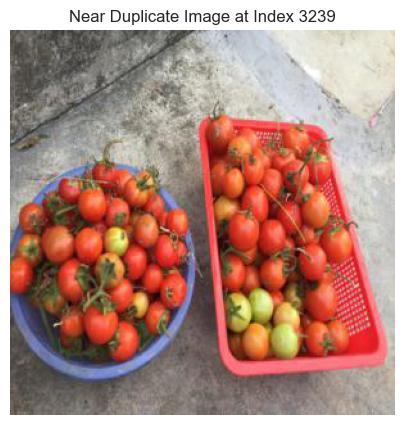

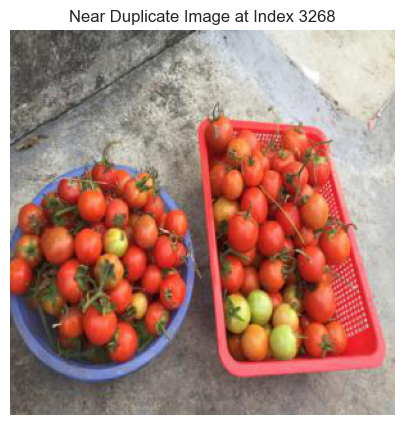

In [15]:
near_duplicates = imagelab.info['near_duplicates']['sets']
all_image_paths = [sample[0] for sample in dataset.samples]

near_duplicate_indices_to_remove = []

for dup_set in near_duplicates:
    duplicates = dup_set[1:]
    near_duplicate_indices_to_remove.extend(duplicates)

print(f"Total near duplicate images to remove: {len(near_duplicate_indices_to_remove)}")
for _ in near_duplicates:
    for idx in _:
        img_path = all_image_paths[idx]
        title = f"Near Duplicate Image at Index {idx}"
        display_images([img_path], [title])

In [57]:
near_duplicate_indices_to_remove

[1488,
 350,
 382,
 387,
 389,
 402,
 437,
 421,
 691,
 394,
 436,
 458,
 428,
 541,
 739,
 2253,
 2946,
 2443,
 3249,
 3268]

# Add all problem indices to a unique set for removal

In [58]:
all_indices_to_remove = set(exact_duplicate_indices_to_remove + odd_size_indices + near_duplicate_indices_to_remove)
print(f"Total unique images to remove: {len(all_indices_to_remove)}")

Total unique images to remove: 89


In [59]:
all_indices_to_remove

{16,
 73,
 145,
 158,
 222,
 350,
 382,
 387,
 389,
 394,
 402,
 418,
 421,
 428,
 436,
 437,
 444,
 458,
 520,
 541,
 542,
 621,
 632,
 633,
 634,
 666,
 691,
 695,
 726,
 739,
 853,
 854,
 855,
 862,
 916,
 995,
 1172,
 1437,
 1488,
 1538,
 1539,
 1540,
 1592,
 1740,
 1752,
 1813,
 1879,
 1932,
 2075,
 2130,
 2213,
 2253,
 2284,
 2309,
 2310,
 2443,
 2466,
 2562,
 2728,
 2914,
 2929,
 2946,
 3056,
 3057,
 3093,
 3097,
 3098,
 3099,
 3100,
 3101,
 3118,
 3149,
 3184,
 3245,
 3249,
 3268,
 3296,
 3342,
 3355,
 3542,
 3869,
 3949,
 4071,
 4072,
 4156,
 4447,
 4448,
 4449,
 4465}

# REMOVING Problem Images

In [60]:
all_image_paths = [sample[0] for sample in dataset.samples]

image_paths_to_remove = {all_image_paths[idx] for idx in all_indices_to_remove}

dataset.samples = [sample for sample in dataset.samples if sample[0] not in image_paths_to_remove]

dataset.imgs = dataset.samples
dataset.targets = [sample[1] for sample in dataset.samples]

print(f"Total images after removal: {len(dataset)}")

Total images after removal: 4396


# Showing that the removed items were correct
### We are now left with some potential issues but appear purposeful to make the model more rigid

Checking for dark, light, odd_aspect_ratio, low_information, exact_duplicates, near_duplicates, blurry, grayscale, odd_size images ...


  0%|          | 0/4396 [00:00<?, ?it/s]

  0%|          | 0/4396 [00:00<?, ?it/s]

Issue checks completed. 15 issues found in the dataset. To see a detailed report of issues found, use imagelab.report().
Issues found in images in order of severity in the dataset

|    | issue_type       |   num_images |
|---:|:-----------------|-------------:|
|  0 | blurry           |            9 |
|  1 | dark             |            3 |
|  2 | low_information  |            3 |
|  3 | light            |            0 |
|  4 | odd_aspect_ratio |            0 |
|  5 | grayscale        |            0 |
|  6 | odd_size         |            0 |
|  7 | exact_duplicates |            0 |
|  8 | near_duplicates  |            0 | 

---------------------- blurry images -----------------------

Number of examples with this issue: 9
Examples representing most severe instances of this issue:


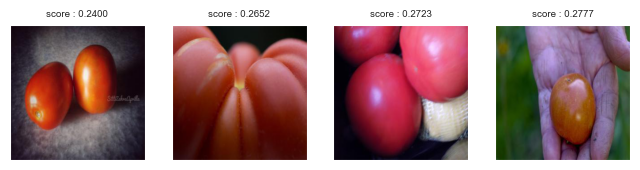

----------------------- dark images ------------------------

Number of examples with this issue: 3
Examples representing most severe instances of this issue:


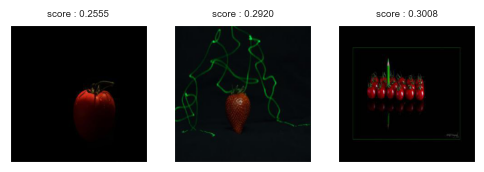

------------------ low_information images ------------------

Number of examples with this issue: 3
Examples representing most severe instances of this issue:


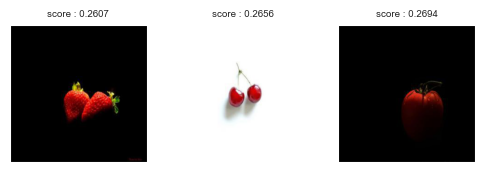

In [63]:
from cleanvision import Imagelab

after = Imagelab(torchvision_dataset=dataset)

after.find_issues()

after.report()

In [66]:
import os

cleaned_dataset_dir = 'train_data_clean'  

os.makedirs(cleaned_dataset_dir, exist_ok=True)

In [67]:
class_names = dataset.classes

for class_name in class_names:
    class_dir = os.path.join(cleaned_dataset_dir, class_name)
    os.makedirs(class_dir, exist_ok=True)

class_names

['cherry', 'strawberry', 'tomato']

In [68]:
import shutil
from tqdm import tqdm

print("Copying cleaned images to the new directory...")

for img_path, class_idx in tqdm(dataset.samples, total=len(dataset.samples)):
    class_name = class_names[class_idx]
    dest_path = os.path.join(cleaned_dataset_dir, class_name, os.path.basename(img_path))
    try:
        shutil.copy2(img_path, dest_path)
    except Exception as e:
        print(f"Error copying {img_path} to {dest_path}: {e}")

print("Export completed.")

Copying cleaned images to the new directory...


100%|██████████| 4396/4396 [00:01<00:00, 2799.71it/s]

Export completed.
